# Proyecto final
Este notebook tiene como objetivo ser presentado como trabajo final del módulo 2 del programa de formación MLDS, este proyecto fue realizado por:



*   Camilo Gutierrez
*   Yenny Paola Dorado




In [ ]:
import seaborn as sns
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib as mpl
import folium
from scipy import stats
import scipy
import statsmodels.api as sm
from folium import plugins
import statsmodels.formula.api as smf
from sklearn import linear_model
import warnings
from sklearn.cluster import KMeans
from sklearn.metrics import pairwise_distances_argmin_min
warnings.simplefilter(action='ignore')

# Descripción del dataset


---


El dataset que se utilizará para este proyecto es de la base de datos de la aplicación Airbnb, la cual se puede consultar en este [link](http://insideairbnb.com/get-the-data.html).
Específicamente, se seleccionó el listado de alojamientos de la ciudad de Londres en Inglaterra, el cual contiene la información detallada de los anuncios publicados de la ciudad.

# Problemas


---

Teniendo en cuenta el resultado del anterior proyecto con la ciudad de Madrid, se propuso analizar la información mediante técnicas de Machine Learning, por lo cual se quiere realizar el mismo análisis del anterior proyecto, pero con la ciudad de **Londres**, la cual es la ciudad con mayor anuncios en Airbnb e implementar modelos supervisados y no supervisados. 

# Objetivos 


---


# Generales

*   Conocer la distribución de precios y reseñas en la ciudad de Londres

# Específicos

*   Agrupar los alojamientos por medio de técnicas de modelos no supervisados.
* Encontrar los alojamientos con mejor relación calidad precio con respecto al agrupamiento realizado.
*   Hacer modelos de regresión para calcular precio aproximado de alojamiento usando parámetros dados.
* Encontrar el mejor modelo según su desempeño.



#Carga de datos

---



In [ ]:
lista_original = pd.read_csv('listings.csv')

In [ ]:
lista_original.head(10)

,id,listing_url,scrape_id,last_scraped,name,description,neighborhood_overview,picture_url,host_id,host_url,...,review_scores_communication,review_scores_location,review_scores_value,license,instant_bookable,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month
0,13913,https://www.airbnb.com/rooms/13913,20211207182339,2021-12-09,Holiday London DB Room Let-on going,My bright double bedroom with a large window h...,Finsbury Park is a friendly melting pot commun...,https://a0.muscache.com/pictures/miso/Hosting-...,54730,https://www.airbnb.com/users/show/54730,...,4.90,4.65,4.75,NaN,f,2,1,1,0,0.16
1,15400,https://www.airbnb.com/rooms/15400,20211207182339,2021-12-09,Bright Chelsea Apartment. Chelsea!,Lots of windows and light. St Luke's Gardens ...,It is Chelsea.,https://a0.muscache.com/pictures/428392/462d26...,60302,https://www.airbnb.com/users/show/60302,...,4.82,4.93,4.73,NaN,f,1,1,0,0,0.61
2,17402,https://www.airbnb.com/rooms/17402,20211207182339,2021-12-09,Superb 3-Bed/2 Bath & Wifi: Trendy W1,You'll have a wonderful stay in this superb mo...,"Location, location, location! You won't find b...",https://a0.muscache.com/pictures/39d5309d-fba7...,67564,https://www.airbnb.com/users/show/67564,...,4.66,4.85,4.59,NaN,f,1,1,0,0,0.33
3,17506,https://www.airbnb.com/rooms/17506,20211207182339,2021-12-09,Boutique Chelsea/Fulham Double bed 5-star ensuite,Enjoy a chic stay in this elegant but fully mo...,Fulham is 'villagey' and residential – a real ...,https://a0.muscache.com/pictures/11901327/e63d...,67915,https://www.airbnb.com/users/show/67915,...,NaN,NaN,NaN,NaN,f,2,0,2,0,NaN
4,25123,https://www.airbnb.com/rooms/25123,20211207182339,2021-12-09,Clean big Room in London (Room 1),Big room with double bed/ clean sheets/ clean ...,Barnet is one of the largest boroughs in Londo...,https://a0.muscache.com/pictures/456905/a004b9...,103583,https://www.airbnb.com/users/show/103583,...,4.89,4.45,4.74,NaN,t,3,0,3,0,0.91
5,33332,https://www.airbnb.com/rooms/33332,20211207182339,2021-12-09,Beautiful Ensuite Richmond-upon-Thames borough,"Walking distance to Twickenham Stadium, 35 min...",Peaceful and friendly.,https://a0.muscache.com/pictures/miso/Hosting-...,144444,https://www.airbnb.com/users/show/144444,...,4.80,4.80,4.30,NaN,f,1,0,1,0,0.08
6,36299,https://www.airbnb.com/rooms/36299,20211207182339,2021-12-09,Kew Gardens 3BR house in cul-de-sac,3 Bed House with garden close to Thames river ...,"Residential family neighborhood, with both Eng...",https://a0.muscache.com/pictures/457052/6e819d...,155938,https://www.airbnb.com/users/show/155938,...,4.96,4.90,4.61,NaN,f,1,1,0,0,0.63
7,36660,https://www.airbnb.com/rooms/36660,20211207182339,2021-12-10,You are GUARANTEED to love this,<b>The space</b><br />This room is located on ...,NaN,https://a0.muscache.com/pictures/7472240/ec624...,157884,https://www.airbnb.com/users/show/157884,...,4.96,4.77,4.85,NaN,t,2,0,2,0,3.99
8,38151,https://www.airbnb.com/rooms/38151,20211207182339,2021-12-09,Double room/ lounge,"<b>The space</b><br />Comfortable, large doubl...",NaN,https://a0.muscache.com/pictures/214176/451fe3...,163634,https://www.airbnb.com/users/show/163634,...,NaN,NaN,NaN,NaN,f,1,0,1,0,NaN
9,38610,https://www.airbnb.com/rooms/38610,20211207182339,2021-12-09,CHARMING FAMILY HOME,"A typical Victorian Terraced London house, col...",Shepherds Bush itself is a prime real estate l...,https://a0.muscache.com/pictures/ace0185e-0f8a...,165579,https://www.airbnb.com/users/show/165579,...,5.00,4.75,4.72,NaN,f,1,1,0,0,0.32


In [ ]:
lista_original.shape

(66641, 74)

# Exploración de los datos

---


Como se puede apreciar en la anterior sección, el Data Set cuenta con 74 variables, por lo cual se creará uno nuevo con las variables que se utilizaran para el análisis de este proyecto. 

In [ ]:
lista=lista_original

In [ ]:
lista=lista.drop(['listing_url','scrape_id','last_scraped','picture_url','host_url','host_since','host_response_time','host_response_rate','host_acceptance_rate','host_is_superhost','host_thumbnail_url','host_picture_url','host_neighbourhood','host_listings_count','host_total_listings_count','host_verifications','host_has_profile_pic','host_identity_verified','neighbourhood_cleansed','neighbourhood_group_cleansed','review_scores_checkin','review_scores_communication','review_scores_location','review_scores_value','license','instant_bookable','calculated_host_listings_count','calculated_host_listings_count_entire_homes','calculated_host_listings_count_private_rooms','calculated_host_listings_count_shared_rooms','reviews_per_month','minimum_minimum_nights','maximum_minimum_nights','minimum_maximum_nights','maximum_maximum_nights','minimum_nights_avg_ntm','maximum_nights_avg_ntm','calendar_updated','has_availability','availability_30','availability_60','availability_90','availability_365','calendar_last_scraped','number_of_reviews_ltm','bathrooms_text','number_of_reviews','bathrooms','number_of_reviews_l30d','first_review','last_review','review_scores_cleanliness','amenities','review_scores_accuracy'], axis=1)

In [ ]:
lista.columns

Index(['id', 'name', 'description', 'neighborhood_overview', 'host_id',
       'host_name', 'host_location', 'host_about', 'neighbourhood', 'latitude',
       'longitude', 'property_type', 'room_type', 'accommodates', 'bedrooms',
       'beds', 'price', 'minimum_nights', 'maximum_nights',
       'review_scores_rating'],
      dtype='object')

Las variables que se utilizaran son:


* **id:**  Número de identificación único del anuncio
* **name:** Nombre de la publicación
* **description:** Descripción del anuncio
* **neighborhood_overview:** Descripción del barrio dada por el arrendatario
* **host_id:** Número de identificación único del arrendatario
* **host_name:** Nombre del arrendatario
* **host_location:** Ubicación del arrendatario
* **host_about:** Descripción del arrendatario
* **neighbourhood:** Nombre del vecindario
* **latitude:** Latitud del hospedaje
* **longitude:** Longitud del hospedaje
* **property_type:** Tipo de propiedad (casa, edificio, hotel …)
* **room_type:** Tipo de habitación (compartida, privada, hotel…)
* **accommodates:** Número máximo de personas
* **bedrooms:** Número de dormitorios
* **beds:** Número de camas
* **price:** Precio por día
* **minimum_nights:** Mínimo de noches
* **maximum_nights:** Máximo de noches
* **review_scores_rating:** Calificación de usuarios al inmueble



Se procedera a realizar una tranformación en alunas variables, para poder realizar el análisis descriptivo.

In [ ]:
lista_original.price

0         $65.00
1         $75.00
2        $265.00
3        $150.00
4         $29.00
          ...   
66636    $120.00
66637    $288.00
66638    $104.00
66639    $402.00
66640     $70.00
Name: price, Length: 66641, dtype: object

In [ ]:
for i in range(lista['price'].size):
  lista['price'][i]=lista['price'][i].replace('$','')
  lista['price'][i]=lista['price'][i].replace(',','')
lista.price = lista.price.astype('float64')
lista.longitude = lista.longitude.astype('float64')
lista.latitude = lista.latitude.astype('float64')


In [ ]:
lista.describe()

,id,host_id,latitude,longitude,accommodates,bedrooms,beds,price,minimum_nights,maximum_nights,review_scores_rating
count,6.664100e+04,6.664100e+04,66641.000000,66641.000000,66641.000000,62624.000000,62995.000000,66641.000000,66641.000000,6.664100e+04,48082.000000
mean,2.842799e+07,1.051238e+08,51.509631,-0.127954,3.004937,1.489253,1.757981,145.207230,6.654852,2.381714e+04,4.540116
std,1.552529e+07,1.140055e+08,0.048334,0.097315,1.927051,0.883943,1.262523,349.932373,30.393704,4.375146e+06,0.913813
min,1.391300e+04,2.010000e+03,51.295937,-0.496160,0.000000,1.000000,1.000000,0.000000,1.000000,1.000000e+00,0.000000
25%,1.586433e+07,1.744935e+07,51.482870,-0.188670,2.000000,1.000000,1.000000,46.000000,1.000000,3.100000e+01,4.500000
50%,2.764398e+07,5.194492e+07,51.513830,-0.124930,2.000000,1.000000,1.000000,83.000000,2.000000,1.125000e+03,4.810000
75%,4.180652e+07,1.657746e+08,51.539960,-0.068960,4.000000,2.000000,2.000000,145.000000,4.000000,1.125000e+03,5.000000
max,5.371305e+07,4.348812e+08,51.679830,0.288570,16.000000,22.000000,38.000000,18557.000000,1125.000000,1.000000e+09,5.000000


Se obtendrán algunas estadísticas descriptivas de los precios y las calificaciones para entender mejor los datos.

In [ ]:

lista['price'].astype('int').describe()


count    66641.000000
mean       145.207230
std        349.932373
min          0.000000
25%         46.000000
50%         83.000000
75%        145.000000
max      18557.000000
Name: price, dtype: float64

In [ ]:
lista['review_scores_rating'].describe()

count    48082.000000
mean         4.540116
std          0.913813
min          0.000000
25%          4.500000
50%          4.810000
75%          5.000000
max          5.000000
Name: review_scores_rating, dtype: float64

Ahora se obtendrá la distribución de estas variables  price y review_scores_rating mediante histogramas y boxplot.

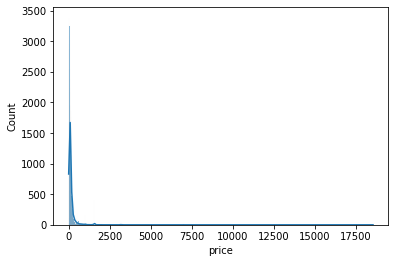

In [ ]:
sns.histplot(lista['price'], kde=True)

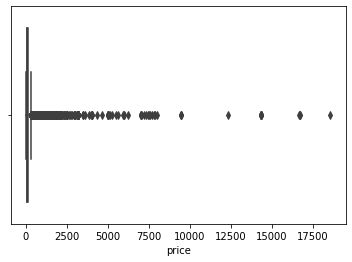

In [ ]:
sns.boxplot(lista['price'])

En las anteriores gráficas se puede observar que los precios por día tienen una distribución asimétrica positiva con varios valores atípicos. 

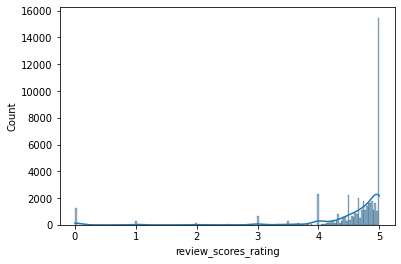

In [ ]:
sns.histplot(lista['review_scores_rating'], kde=True)

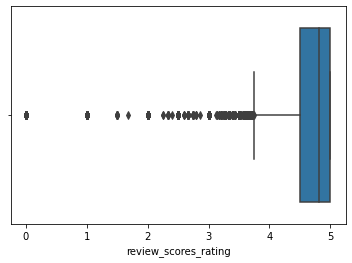

In [ ]:
sns.boxplot(lista['review_scores_rating'])

En las anteriores gráficas se puede observar que los review_scores_rating (Calificación de usuarios al inmueble) tienen una distribución asimétrica negativa con algunas calificaciones en cero. 

Ahora miremos la distribución de precios de los alojamientos a través de un mapa de calor

In [ ]:
heat_data = lista.groupby(["latitude","longitude"])['price'].mean().reset_index().values.tolist() 
mapa = folium.Map(location=[51.5072,  -0.1275 ], zoom_start=13) 
folium.plugins.HeatMap(heat_data,blur=50 ).add_to(mapa)
mapa

Como el mapa se ve muy saturado se agrupó por zonas

In [ ]:
m = folium.Map(location=[51.5072,  -0.1275 ], zoom_start=13)
locations = list(zip(lista.latitude, lista.longitude))
cluster = plugins.MarkerCluster(locations=locations)  
m.add_child(cluster)
m


# Preparación de los datos

---


Después de analizar los histogramas, boxplots y  mapas, se llegó a la conclusión de que hay demasiados datos que no serán necesarios en el análisis que se llevara a cabo posteriormente, por lo cual se hará lo siguiente:


*   Limpiar los datos que tengan valor nulo en campos importantes para el análisis
*   Poner un tope por arriba y abajo de valor de renta, dado que hay demasiados outliers (ver boxplot)



In [ ]:
lista.isnull().sum().to_frame()

,0
id,0
name,24
description,2344
neighborhood_overview,26674
host_id,0
host_name,59
host_location,201
host_about,29692
neighbourhood,26673
latitude,0


In [ ]:
lista.shape

(66641, 20)

Se eliminan los null de las calificaciones y de número de camas

In [ ]:
lista = lista[lista['review_scores_rating'].notna()]
lista = lista[lista['beds'].notna()]
lista = lista[lista['bedrooms'].notna()]
lista.reset_index(drop=True, inplace=True)
lista.isnull().sum().to_frame()

,0
id,0
name,8
description,804
neighborhood_overview,13771
host_id,0
host_name,36
host_location,102
host_about,17795
neighbourhood,13770
latitude,0


In [ ]:
lista.shape

(43465, 20)

In [ ]:
lista.head(15)

,id,name,description,neighborhood_overview,host_id,host_name,host_location,host_about,neighbourhood,latitude,longitude,property_type,room_type,accommodates,bedrooms,beds,price,minimum_nights,maximum_nights,review_scores_rating
0,15400,Bright Chelsea Apartment. Chelsea!,Lots of windows and light. St Luke's Gardens ...,It is Chelsea.,60302,Philippa,"Kensington, England, United Kingdom","English, grandmother, I have travelled quite ...","London, United Kingdom",51.48780,-0.16813,Entire rental unit,Entire home/apt,2,1.0,1.0,75.0,3,50,4.79
1,17402,Superb 3-Bed/2 Bath & Wifi: Trendy W1,You'll have a wonderful stay in this superb mo...,"Location, location, location! You won't find b...",67564,Liz,"Brighton and Hove, England, United Kingdom",We are Liz and Jack. We manage a number of ho...,"London, Fitzrovia, United Kingdom",51.52195,-0.14094,Entire rental unit,Entire home/apt,6,3.0,3.0,265.0,4,365,4.69
2,33332,Beautiful Ensuite Richmond-upon-Thames borough,"Walking distance to Twickenham Stadium, 35 min...",Peaceful and friendly.,144444,Chi-Chi,"Isleworth, England, United Kingdom",Quite busy and often in a different place ever...,"Twickenham, England, United Kingdom",51.46416,-0.32554,Private room in residential home,Private room,2,1.0,1.0,65.0,2,21,4.55
3,36299,Kew Gardens 3BR house in cul-de-sac,3 Bed House with garden close to Thames river ...,"Residential family neighborhood, with both Eng...",155938,Geert,"Richmond, England, United Kingdom",.,"Richmond, United Kingdom, United Kingdom",51.48085,-0.28086,Entire townhouse,Entire home/apt,5,3.0,3.0,195.0,3,22,4.82
4,38610,CHARMING FAMILY HOME,"A typical Victorian Terraced London house, col...",Shepherds Bush itself is a prime real estate l...,165579,Elisa & Dom,United Kingdom,We are Elisa and Dominic and we live in West L...,"London, United Kingdom",51.50701,-0.23362,Entire townhouse,Entire home/apt,8,4.0,4.0,190.0,30,1125,4.86
5,38995,SPACIOUS ROOM IN CONTEMPORARY STYLE FLAT,Welcome to my place! I am offering a large roo...,Peckham itself is a vibrant and fashionable ar...,167281,Cesar,"London, England, United Kingdom","Hi, I am Cesar. Welcome to my place. I love d...","London, United Kingdom",51.47860,-0.06114,Private room in rental unit,Private room,2,1.0,1.0,42.0,1,7,5.00
6,39387,Stylish bedsit in Notting Hill ish flat.,Private lockable bedsit room available within ...,My place is convenient for all London attracti...,168920,Alec,"London, England, United Kingdom",Relaxed and mature kinda guy into creative art...,"London, England, United Kingdom",51.52605,-0.19942,Private room in condominium (condo),Private room,1,1.0,1.0,42.0,5,10,4.50
7,41311,Clean big Room in London (Room 2),Big room with double bed/ clean sheets/ clean ...,Barnet is one of the largest boroughs in Londo...,103583,Grace,"London, England, United Kingdom","Easy going, friendly\n\nAttentive to detail an...","Barnet, England, United Kingdom",51.57400,-0.21058,Private room in residential home,Private room,2,1.0,1.0,25.0,10,1124,4.90
8,41445,2 Double bed apartment in quiet area North London,The apartment is on the ground floor (no stair...,Quite area popular with families,180838,Sean,"Edgware, England, United Kingdom","I am originally from Dublin Ireland, I have li...","London, United Kingdom",51.61492,-0.25632,Entire rental unit,Entire home/apt,4,2.0,3.0,250.0,4,1125,4.56
9,41509,Room in maisonette in chiswick,Double bed on 1st floor. 2 extra single beds i...,"great access to restaurants and cafes, and ea...",181028,Peter,"London, England, United Kingdom","(Hidden by Airbnb) Likes:\r\nPicnics, I Love t...","Hounslow, Greater London, United Kingdom",51.49351,-0.25568,Private room in rental unit,Private room,4,1.0,3.0,150.0,1,50,4.50


Ahora se define un rango de precio usando como referencia el boxplot

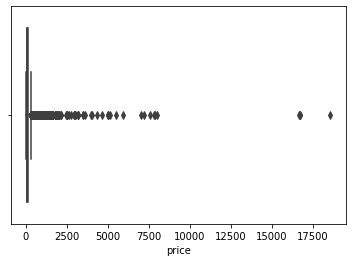

In [ ]:
sns.boxplot(lista['price'])

Después de ver el gráfico, se fija el rango del precio entre 10 y 300 

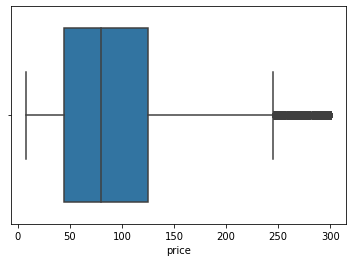

In [ ]:
lista= lista[lista['price'] <= 300]
lista= lista[lista['price'] >= 5]
sns.boxplot(lista['price'])

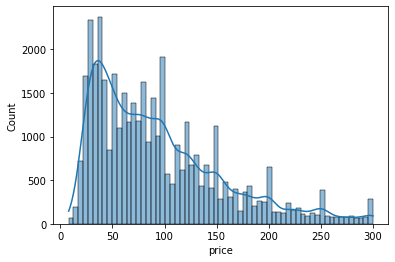

In [ ]:
sns.histplot(lista['price'], kde=True)

In [ ]:
lista.shape

(40985, 20)

La diferencia en los boxplot es clara, sin embargo, se descartaron casi el 30% de los datos. Esta cifra es alta, pero no es preocupante porque si tenemos en cuenta nuestros objetivos, no estamos interesados en ese casi 30% descartado.
Por lo cual se prosigue con el agrupamiento de los alojamientos.

# Modelos de Regresión

---


Ahora se implementaran los modelos de regresion para predecir el precio del alojamiento. Para comenzar se hace una copia del dataset para realizar el preprocesamiento.

In [ ]:
Lista_R=lista

Ahora se eliminan las columnas que no se consideran relevantes en el análisis.

In [ ]:
Lista_R=Lista_R.drop(['id', 'name', 'description', 'neighborhood_overview', 'host_id','host_name', 'host_location', 'host_about', 'neighbourhood'], axis=1)

In [ ]:
Lista_R.isnull().sum().to_frame()

,0
latitude,0
longitude,0
property_type,0
room_type,0
accommodates,0
bedrooms,0
beds,0
price,0
minimum_nights,0
maximum_nights,0


In [ ]:
Lista_R.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 40985 entries, 0 to 43464
Data columns (total 11 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   latitude              40985 non-null  float64
 1   longitude             40985 non-null  float64
 2   property_type         40985 non-null  object 
 3   room_type             40985 non-null  object 
 4   accommodates          40985 non-null  int64  
 5   bedrooms              40985 non-null  float64
 6   beds                  40985 non-null  float64
 7   price                 40985 non-null  float64
 8   minimum_nights        40985 non-null  int64  
 9   maximum_nights        40985 non-null  int64  
 10  review_scores_rating  40985 non-null  float64
dtypes: float64(6), int64(3), object(2)
memory usage: 3.8+ MB


In [ ]:
corr = Lista_R.corr()
corr.style.background_gradient(cmap='coolwarm')

,latitude,longitude,accommodates,bedrooms,beds,price,minimum_nights,maximum_nights,review_scores_rating
latitude,1.000000,0.119141,0.003060,-0.009822,-0.003983,-0.004488,0.005282,-0.001471,-0.010839
longitude,0.119141,1.000000,-0.016569,-0.017547,-0.024213,-0.093544,0.011071,-0.004870,-0.000367
accommodates,0.003060,-0.016569,1.000000,0.784801,0.813299,0.609832,0.004027,-0.002598,0.023376
bedrooms,-0.009822,-0.017547,0.784801,1.000000,0.761355,0.530357,0.009639,-0.003689,0.019609
beds,-0.003983,-0.024213,0.813299,0.761355,1.000000,0.481513,0.003970,-0.004169,0.010161
price,-0.004488,-0.093544,0.609832,0.530357,0.481513,1.000000,0.010616,-0.004954,0.044737
minimum_nights,0.005282,0.011071,0.004027,0.009639,0.003970,0.010616,1.000000,0.003834,-0.007340
maximum_nights,-0.001471,-0.004870,-0.002598,-0.003689,-0.004169,-0.004954,0.003834,1.000000,0.001638
review_scores_rating,-0.010839,-0.000367,0.023376,0.019609,0.010161,0.044737,-0.007340,0.001638,1.000000


Antes de comenzar con las regresiones, se hara el preprocesamiento de los datos, por lo cual, se normalizaran y se transformara los datos de tipo texto.

In [ ]:
X_categoric = Lista_R[['room_type']].values
X_categoric

array([['Entire home/apt'],
       ['Entire home/apt'],
       ['Private room'],
       ...,
       ['Private room'],
       ['Entire home/apt'],
       ['Private room']], dtype=object)

In [ ]:
from sklearn.preprocessing import OneHotEncoder

enc = OneHotEncoder(sparse=False)
X_categoric_onehot = enc.fit_transform(X_categoric) 
print(X_categoric_onehot.shape)
print(type(X_categoric_onehot))

(40985, 4)
<class 'numpy.ndarray'>


In [ ]:
dfOH = pd.DataFrame (X_categoric_onehot, columns = ['Entire home/apt','Hotel room','Private room','Shared room'])

In [ ]:
dfOH

,Entire home/apt,Hotel room,Private room,Shared room
0,1.0,0.0,0.0,0.0
1,1.0,0.0,0.0,0.0
2,0.0,0.0,1.0,0.0
3,1.0,0.0,0.0,0.0
4,1.0,0.0,0.0,0.0
...,...,...,...,...
40980,0.0,0.0,1.0,0.0
40981,1.0,0.0,0.0,0.0
40982,0.0,0.0,1.0,0.0
40983,1.0,0.0,0.0,0.0


In [ ]:
Lista_R.reset_index(inplace=True)

In [ ]:
full=pd.concat([Lista_R,dfOH],axis=1)

In [ ]:
full=full.drop(['property_type'	,'room_type'],axis=1)

In [ ]:
from sklearn.preprocessing import MinMaxScaler
#Normalizar
#Se crea el normalizador
normalizador = MinMaxScaler()
#Se ajusta los datos requeridos
full[['price']] = normalizador.fit_transform(full[['price']])

In [ ]:
from sklearn.model_selection import KFold
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression, Ridge
from sklearn.preprocessing import StandardScaler, PolynomialFeatures
from sklearn.model_selection import cross_val_score
from sklearn.metrics import accuracy_score
from sklearn.metrics import r2_score

X, y = full.drop(['price'],axis=1), full['price']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=.2) 


In [ ]:
from sklearn import metrics
from scipy import stats

def show_metrics(prediction_test, prediction_train, y_test, y_train):
    MAE = round(metrics.mean_absolute_error(y_test, prediction_test), 2)
    MSE = round(metrics.mean_squared_error(y_test, prediction_test), 2)
    RMSE = round(np.sqrt(metrics.mean_squared_error(y_test, prediction_test)), 2)
    RMSE_ratio_test= round(np.sqrt(metrics.mean_squared_error(y_test, prediction_test)) / np.mean(y_test),3)
    RMSE_ratio_train = round(np.sqrt(metrics.mean_squared_error(y_train, prediction_train)) / np.mean(y_train),3)
    R_2_test = round(metrics.explained_variance_score(y_test, prediction_test), 2)
    R_2_train = round(metrics.explained_variance_score(y_train, prediction_train), 2)
    
    metrics_data = pd.DataFrame(data = [MAE, MSE, RMSE, RMSE_ratio_test, 
                                    RMSE_ratio_train, R_2_test, R_2_train]).T
    
    metrics_data.columns = ['MAE', 'MSE', 'RMSE', 'RMSE_ratio_test', 
                                    'RMSE_ratio_train', 'R_2_test', 'R_2_train']
    display(metrics_data)

##Regresion Lineal Múltiple

---
Un modelo de regresión lineal múltiple es un modelo estadístico versátil para evaluar las relaciones entre un destino continuo y los predictores.

Tomado de: https://www.ibm.com/docs/es/cognos-analytics/11.1.0?topic=tests-multiple-linear-regression 


In [ ]:

model = LinearRegression()
kf = KFold(n_splits=5, shuffle=True,random_state=110)
c=cross_val_score(model, X_train, y_train,
                cv=kf, 
                scoring='r2')
model.fit(X_train, y_train)
y_pred = model.predict(X_test)
print(c)      
print(np.mean(c))
print(f'Coeficiente de Determinación usando score:, {model.score(X_test, y_test):.4f}')
print(f'Coeficiente de Determinación con r2_score:, {r2_score(y_test, y_pred):.4f}')

[ 5.15526531e-01  5.01046733e-01  5.08910682e-01  5.06181220e-01
 -5.88374841e+04]
-11767.090496019347
Coeficiente de Determinación usando score:, 0.4869
Coeficiente de Determinación con r2_score:, 0.4869


,MAE,MSE,RMSE,RMSE_ratio_test,RMSE_ratio_train,R_2_test,R_2_train
0,0.11,0.02,0.15,0.512,0.506,0.49,0.51


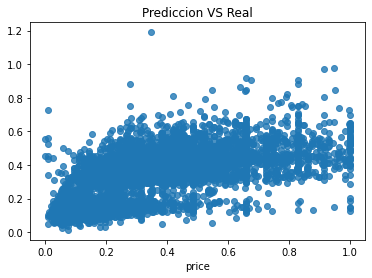

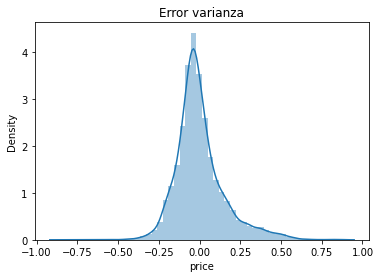

In [ ]:
prediction_test = model.predict(X_test)
prediction_train = model.predict(X_train)
        
    
show_metrics(prediction_test, prediction_train, y_test, y_train)
    
sns.regplot(x = y_test, y = prediction_test, fit_reg=False)
plt.title('Prediccion VS Real')
plt.show()

sns.distplot(y_test - prediction_test, bins = 50)
plt.title('Error varianza')
plt.show()

## Regresion Ridge

---
La regresión Ridge reduce los coeficientes introduciendo un término de penalización igual a la suma de coeficientes cuadrados por un coeficiente de penalización. Este coeficiente puede variar de 0 (sin penalización) a 1; el procedimiento buscará el "mejor" valor de penalización si especifica un rango e incremento.



In [ ]:
model = Ridge(alpha=1)
c=cross_val_score(model, X, y,
                cv=kf,
                scoring='r2')
model.fit(X_train, y_train)
y_pred = model.predict(X_test)
print(c)
print(np.mean(c))
print(f'Coeficiente de Determinación usando score:, {model.score(X_test, y_test):.4f}')
print(f'Coeficiente de Determinación con r2_score:, {r2_score(y_test, y_pred):.4f}')

[0.50776165 0.50994693 0.50411367 0.49157254 0.50212946]
0.5031048491535393
Coeficiente de Determinación usando score:, 0.4869
Coeficiente de Determinación con r2_score:, 0.4869


,MAE,MSE,RMSE,RMSE_ratio_test,RMSE_ratio_train,R_2_test,R_2_train
0,0.11,0.02,0.15,0.512,0.506,0.49,0.51


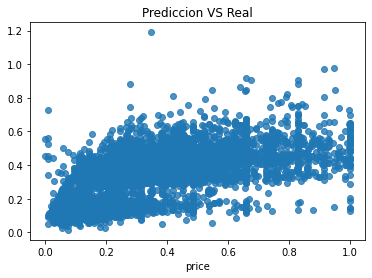

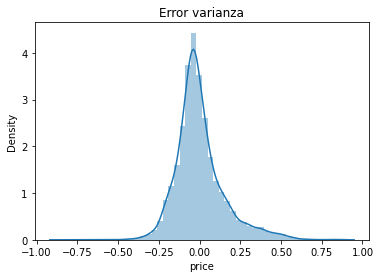

In [ ]:
prediction_test = model.predict(X_test)
prediction_train = model.predict(X_train)
        
    
show_metrics(prediction_test, prediction_train, y_test, y_train)
    
sns.regplot(x = y_test, y = prediction_test, fit_reg=False)
plt.title('Prediccion VS Real')
plt.show()

sns.distplot(y_test - prediction_test, bins = 50)
plt.title('Error varianza')
plt.show()

## XGboost

---
Este algoritmo se caracteriza por obtener buenos resultados de predicción con relativamente poco esfuerzo, en muchos casos equiparables o mejores que los devueltos por modelos más complejos computacionalmente, en particular para problemas con datos heterogéneos.

XGBoost es una herramienta muy útil para un data scientist y cuenta con implementaciones para diferentes lenguajes y entornos de programación.

Tomado de: https://medium.com/@jboscomendoza/xgboost-en-r-398e7c84998e


In [ ]:
import xgboost as xgb
from sklearn.metrics import  mean_squared_error, r2_score


model = xgb.XGBRegressor()
c=cross_val_score(model, X, y, 
                cv=kf,
                scoring='r2')
model.fit(X_train, y_train)
y_pred = model.predict(X_test)
print(f'Coeficiente de Determinación usando score:, {model.score(X_test, y_test):.4f}')
print(f'Coeficiente de Determinación con r2_score:, {r2_score(y_test, y_pred):.4f}')

[03:31:42] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[03:31:45] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[03:31:48] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[03:31:50] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[03:31:52] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[03:31:54] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
Coeficiente de Determinación usando score:, 0.5946
Coeficiente de Determinación con r2_score:, 0.5946


In [ ]:
print(c)
print(np.mean(c))

[0.60529247 0.60982916 0.59789991 0.59355955 0.61151927]
0.6036200754586712


,MAE,MSE,RMSE,RMSE_ratio_test,RMSE_ratio_train,R_2_test,R_2_train
0,0.09,0.02,0.13,0.455,0.445,0.59,0.62


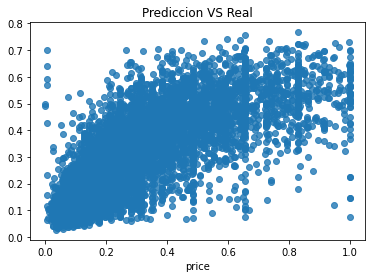

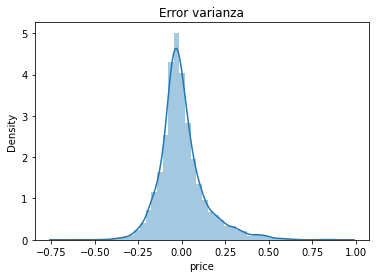

In [ ]:
prediction_test = model.predict(X_test)
prediction_train = model.predict(X_train)
        
    
show_metrics(prediction_test, prediction_train, y_test, y_train)
    
sns.regplot(x = y_test, y = prediction_test, fit_reg=False)
plt.title('Prediccion VS Real')
plt.show()

sns.distplot(y_test - prediction_test, bins = 50)
plt.title('Error varianza')
plt.show()

## Random Forest

---
Es un método versátil de aprendizaje automático capaz de realizar tanto tareas de regresión como de clasificación. También lleva a cabo métodos de reducción dimensional, trata valores perdidos, valores atípicos y otros pasos esenciales de exploración de datos. Es un tipo de método de aprendizaje por conjuntos, donde un grupo de modelos débiles se combinan para formar un modelo poderoso.

Tomado de: https://aprendeia.com/aprendizaje-supervisado-random-forest-classification/ 

In [ ]:
from sklearn.ensemble import RandomForestRegressor


model = RandomForestRegressor(n_estimators = 500)
c=cross_val_score(model, X, y, 
                cv=kf,
                scoring='r2')
model.fit(X_train, y_train)
y_pred = model.predict(X_test)
print(c)
print(np.mean(c))
print(f'Coeficiente de Determinación usando score:, {model.score(X_test, y_test):.4f}')
print(f'Coeficiente de Determinación con r2_score:, {r2_score(y_test, y_pred):.4f}')

[0.64146247 0.64619981 0.63171675 0.62757394 0.6533899 ]
0.6400685742327943
Coeficiente de Determinación usando score:, 0.6246
Coeficiente de Determinación con r2_score:, 0.6246


,MAE,MSE,RMSE,RMSE_ratio_test,RMSE_ratio_train,R_2_test,R_2_train
0,0.09,0.02,0.13,0.438,0.158,0.62,0.95


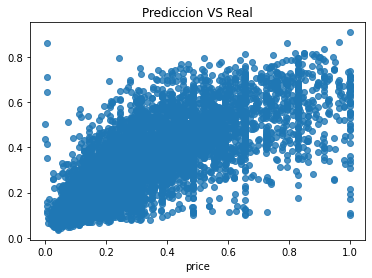

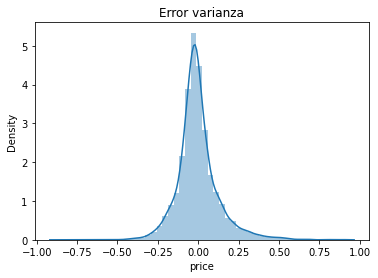

In [ ]:
prediction_test = model.predict(X_test)
prediction_train = model.predict(X_train)
        
    
show_metrics(prediction_test, prediction_train, y_test, y_train)
    
sns.regplot(x = y_test, y = prediction_test, fit_reg=False)
plt.title('Prediccion VS Real')
plt.show()

sns.distplot(y_test - prediction_test, bins = 50)
plt.title('Error varianza')
plt.show()

#Elección modelos

Después de ver el desempeño de los modelos, se eligen Random Forest y  XGboost, por lo cual se ajustará el df y se usarán técnicas de ML para encontrar los mejores hiperparametros con el fin de generar una mejor predicción

In [ ]:
full

,index,latitude,longitude,accommodates,bedrooms,beds,price,minimum_nights,maximum_nights,review_scores_rating,Entire home/apt,Hotel room,Private room,Shared room
0,0,51.487800,-0.168130,2,1.0,1.0,0.229452,3,50,4.79,1.0,0.0,0.0,0.0
1,1,51.521950,-0.140940,6,3.0,3.0,0.880137,4,365,4.69,1.0,0.0,0.0,0.0
2,2,51.464160,-0.325540,2,1.0,1.0,0.195205,2,21,4.55,0.0,0.0,1.0,0.0
3,3,51.480850,-0.280860,5,3.0,3.0,0.640411,3,22,4.82,1.0,0.0,0.0,0.0
4,4,51.507010,-0.233620,8,4.0,4.0,0.623288,30,1125,4.86,1.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
40980,43460,51.419203,-0.081661,2,1.0,1.0,0.126712,1,365,4.00,0.0,0.0,1.0,0.0
40981,43461,51.529090,-0.280590,4,2.0,3.0,0.506849,2,365,5.00,1.0,0.0,0.0,0.0
40982,43462,51.604068,-0.479865,2,1.0,1.0,0.095890,1,10,1.00,0.0,0.0,1.0,0.0
40983,43463,51.504053,-0.215707,4,1.0,2.0,0.339041,1,1125,5.00,1.0,0.0,0.0,0.0


In [ ]:
full2=full.drop([	'minimum_nights',	'maximum_nights'],axis=1)

In [ ]:
full2.corr()

,index,latitude,longitude,accommodates,bedrooms,beds,price,review_scores_rating,Entire home/apt,Hotel room,Private room,Shared room
index,1.000000,-0.020467,-0.001370,0.033725,0.007204,0.030804,0.114990,0.003590,0.065903,0.006924,-0.065713,-0.007826
latitude,-0.020467,1.000000,0.119141,0.003060,-0.009822,-0.003983,-0.004488,-0.010839,0.003080,0.022344,-0.004851,-0.005752
longitude,-0.001370,0.119141,1.000000,-0.016569,-0.017547,-0.024213,-0.093544,-0.000367,-0.031869,-0.011132,0.032320,0.006268
accommodates,0.033725,0.003060,-0.016569,1.000000,0.784801,0.813299,0.609832,0.023376,0.554425,-0.015021,-0.552538,-0.009810
bedrooms,0.007204,-0.009822,-0.017547,0.784801,1.000000,0.761355,0.530357,0.019609,0.425239,-0.014266,-0.418593,-0.040482
beds,0.030804,-0.003983,-0.024213,0.813299,0.761355,1.000000,0.481513,0.010161,0.391574,0.001996,-0.405723,0.087728
price,0.114990,-0.004488,-0.093544,0.609832,0.530357,0.481513,1.000000,0.044737,0.612489,0.019959,-0.607366,-0.060289
review_scores_rating,0.003590,-0.010839,-0.000367,0.023376,0.019609,0.010161,0.044737,1.000000,0.050405,-0.004399,-0.042446,-0.051118
Entire home/apt,0.065903,0.003080,-0.031869,0.554425,0.425239,0.391574,0.612489,0.050405,1.000000,-0.065897,-0.982321,-0.083476
Hotel room,0.006924,0.022344,-0.011132,-0.015021,-0.014266,0.001996,0.019959,-0.004399,-0.065897,1.000000,-0.050362,-0.004280


In [ ]:
full2

,index,latitude,longitude,accommodates,bedrooms,beds,price,review_scores_rating,Entire home/apt,Hotel room,Private room,Shared room
0,0,51.487800,-0.168130,2,1.0,1.0,0.229452,4.79,1.0,0.0,0.0,0.0
1,1,51.521950,-0.140940,6,3.0,3.0,0.880137,4.69,1.0,0.0,0.0,0.0
2,2,51.464160,-0.325540,2,1.0,1.0,0.195205,4.55,0.0,0.0,1.0,0.0
3,3,51.480850,-0.280860,5,3.0,3.0,0.640411,4.82,1.0,0.0,0.0,0.0
4,4,51.507010,-0.233620,8,4.0,4.0,0.623288,4.86,1.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...
40980,43460,51.419203,-0.081661,2,1.0,1.0,0.126712,4.00,0.0,0.0,1.0,0.0
40981,43461,51.529090,-0.280590,4,2.0,3.0,0.506849,5.00,1.0,0.0,0.0,0.0
40982,43462,51.604068,-0.479865,2,1.0,1.0,0.095890,1.00,0.0,0.0,1.0,0.0
40983,43463,51.504053,-0.215707,4,1.0,2.0,0.339041,5.00,1.0,0.0,0.0,0.0


In [ ]:
X, y = full2.drop(['price'],axis=1), full2['price']
X, X_test, y, y_test = train_test_split(X, y, test_size=.2)
X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=.25)

In [ ]:

model = RandomForestRegressor(n_estimators = 500)

model.fit(X_train, y_train)


pred_train = model.predict(X_train)


pred_val = model.predict(X_val)

print("\nTraining MSE:", round(mean_squared_error(y_train, pred_train),4))
print("Validation MSE:", round(mean_squared_error(y_val, pred_val),4))
print("\nTraining r2:", round(r2_score(y_train, pred_train),4))
print("Validation r2:", round(r2_score(y_val, pred_val),4))


Training MSE: 0.0023
Validation MSE: 0.0165

Training r2: 0.9487
Validation r2: 0.6132


,MAE,MSE,RMSE,RMSE_ratio_test,RMSE_ratio_train,R_2_test,R_2_train
0,0.09,0.02,0.13,0.44,0.163,0.63,0.95


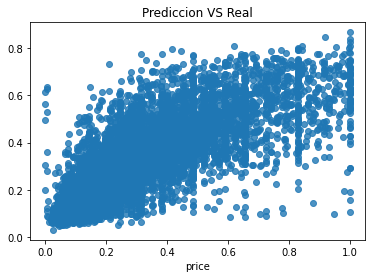

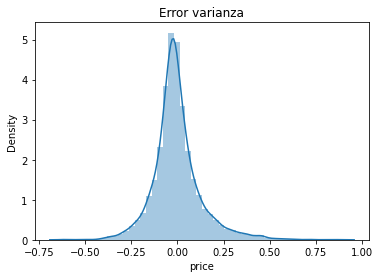

In [ ]:
prediction_test = model.predict(X_test)
prediction_train = model.predict(X_train)
        
    
show_metrics(prediction_test, prediction_train, y_test, y_train)
    
sns.regplot(x = y_test, y = prediction_test, fit_reg=False)
plt.title('Prediccion VS Real')
plt.show()

sns.distplot(y_test - prediction_test, bins = 50)
plt.title('Error varianza')
plt.show()

In [ ]:
from sklearn.model_selection import GridSearchCV

xgbcv = xgb.XGBRegressor(n_jobs = -1, verbose = 10, verbosity = 1, n_estimators = 50, min_child_weight=5)

gparameters = {'learning_rate': [0.13, 0.17, 0.21], 'max_depth': [25, 27, 30],
               'reg_lambda': [0.5, 0.9, 1.3]}

GridSearch = GridSearchCV(xgbcv, param_grid = gparameters, scoring='r2',
                          verbose = 10, cv = 3)

GridSearch.fit(X_train, y_train)

Fitting 3 folds for each of 27 candidates, totalling 81 fits
[CV 1/3; 1/27] START learning_rate=0.13, max_depth=25, reg_lambda=0.5...........
[03:43:02] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[CV 1/3; 1/27] END learning_rate=0.13, max_depth=25, reg_lambda=0.5;, score=0.568 total time=   4.3s
[CV 2/3; 1/27] START learning_rate=0.13, max_depth=25, reg_lambda=0.5...........
[03:43:07] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[CV 2/3; 1/27] END learning_rate=0.13, max_depth=25, reg_lambda=0.5;, score=0.586 total time=   4.3s
[CV 3/3; 1/27] START learning_rate=0.13, max_depth=25, reg_lambda=0.5...........
[03:43:11] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[CV 3/3; 1/27] END learning_rate=0.13, max_depth=25, reg_lambda=0.5;, score=0.582 total time=   4.3s
[CV 1/3; 2/2

GridSearchCV(cv=3,
             estimator=XGBRegressor(min_child_weight=5, n_estimators=50,
                                    n_jobs=-1, verbose=10),
             param_grid={'learning_rate': [0.13, 0.17, 0.21],
                         'max_depth': [25, 27, 30],
                         'reg_lambda': [0.5, 0.9, 1.3]},
             scoring='r2', verbose=10)

In [ ]:
GridSearch.best_params_

{'learning_rate': 0.13, 'max_depth': 25, 'reg_lambda': 1.3}

In [ ]:
y_pred = GridSearch.predict(X_test)
print(f'El coeficiente de determinación (partición de prueba): {r2_score(y_test, y_pred):.6f}')


El coeficiente de determinación (partición de prueba): 0.604304


In [ ]:

model1 = xgb.XGBRegressor(n_jobs = -1, verbose = 10, verbosity = 1, n_estimators = 50, min_child_weight=5,learning_rate=.13, max_depth=25, reg_lambda= 1.3)

model1.fit(X_train, y_train)


pred_train = model1.predict(X_train)


pred_val = model1.predict(X_val)

print("\nTraining MSE:", round(mean_squared_error(y_train, pred_train),4))
print("Validation MSE:", round(mean_squared_error(y_val, pred_val),4))
print("\nTraining r2:", round(r2_score(y_train, pred_train),4))
print("Validation r2:", round(r2_score(y_val, pred_val),4))

[04:16:39] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.

Training MSE: 0.001
Validation MSE: 0.0175

Training r2: 0.9789
Validation r2: 0.5888


In [ ]:
prediction_test = model1.predict(X_test)
prediction_train = model1.predict(X_train)
show_metrics(prediction_test, prediction_train, y_test, y_train)
    
sns.regplot(x = y_test, y = prediction_test, fit_reg=False)
plt.title('Prediccion VS Real')
plt.show()

sns.distplot(y_test - prediction_test, bins = 50)
plt.title('Error varianza')
plt.show()

In [ ]:
from sklearn.model_selection import RandomizedSearchCV
# Number of trees in random forest
n_estimators = [int(x) for x in np.linspace(start = 200, stop = 2000, num = 3)]
# Number of features to consider at every split
max_features = ['auto', 'sqrt']
# Maximum number of levels in tree
max_depth = [int(x) for x in np.linspace(10, 1000, num = 3)]
max_depth.append(None)
# Minimum number of samples required to split a node
min_samples_split = [2, 5, 10]
# Minimum number of samples required at each leaf node
min_samples_leaf = [1, 2, 4]
# Method of selecting samples for training each tree
bootstrap = [True, False]
# Create the random grid
random_grid = {'n_estimators': n_estimators,
               'max_features': max_features,
               'max_depth': max_depth,
               'min_samples_split': min_samples_split,
               'min_samples_leaf': min_samples_leaf,
               'bootstrap': bootstrap}
print(random_grid)

{'n_estimators': [200, 1100, 2000], 'max_features': ['auto', 'sqrt'], 'max_depth': [10, 505, 1000, None], 'min_samples_split': [2, 5, 10], 'min_samples_leaf': [1, 2, 4], 'bootstrap': [True, False]}


In [ ]:

model = RandomForestRegressor()

model2 = RandomizedSearchCV(estimator = model, param_distributions = random_grid, n_iter = 10, cv = 3, verbose=2, random_state=42, n_jobs = -1)

model2.fit(X_train, y_train)

pred_train = model2.predict(X_train)


pred_val = model2.predict(X_val)

print("\nTraining MSE:", round(mean_squared_error(y_train, pred_train),4))
print("Validation MSE:", round(mean_squared_error(y_val, pred_val),4))
print("\nTraining r2:", round(r2_score(y_train, pred_train),4))
print("Validation r2:", round(r2_score(y_val, pred_val),4))

Fitting 3 folds for each of 10 candidates, totalling 30 fits

Training MSE: 0.0069
Validation MSE: 0.0163

Training r2: 0.8473
Validation r2: 0.6177


In [ ]:
model2.best_params_

{'bootstrap': True,
 'max_depth': 1000,
 'max_features': 'sqrt',
 'min_samples_leaf': 2,
 'min_samples_split': 5,
 'n_estimators': 1100}

In [ ]:
model3=RandomForestRegressor(bootstrap= True, max_depth=1000,
 max_features= 'sqrt',
 min_samples_leaf=2,
 min_samples_split=5,
 n_estimators=1100)
model3.fit(X_train, y_train)


RandomForestRegressor(max_depth=1000, max_features='sqrt', min_samples_leaf=2,
                      min_samples_split=5, n_estimators=1100)

,MAE,MSE,RMSE,RMSE_ratio_test,RMSE_ratio_train,R_2_test,R_2_train
0,0.09,0.02,0.13,0.437,0.281,0.64,0.85


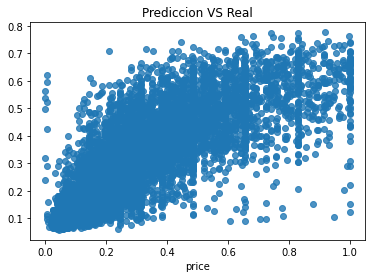

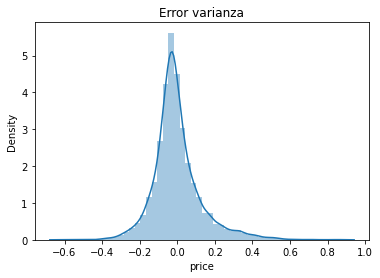

In [ ]:
prediction_test = model3.predict(X_test)
prediction_train = model3.predict(X_train)
show_metrics(prediction_test, prediction_train, y_test, y_train)
    
sns.regplot(x = y_test, y = prediction_test, fit_reg=False)
plt.title('Prediccion VS Real')
plt.show()

sns.distplot(y_test - prediction_test, bins = 50)
plt.title('Error varianza')
plt.show()

# Modelos de Agrupación

---

De acuerdo a la información anterior, se implementa el modelo de K means para determinar que características influyen en los precios de los anuncios.

In [ ]:
Var_Num = pd.DataFrame(lista,columns =['accommodates',	'bedrooms',	'beds',	'price',	'minimum_nights',	'maximum_nights',	'review_scores_rating'])

In [ ]:
from sklearn.preprocessing import MinMaxScaler
#Normalizar
#Se crea el normalizador
normalizador = MinMaxScaler()
#Se ajusta los datos requeridos
Var_Num[['price']] = normalizador.fit_transform(Var_Num[['price']])
Var_Num[['minimum_nights']] = normalizador.fit_transform(Var_Num[['minimum_nights']])
Var_Num[['maximum_nights']] = normalizador.fit_transform(Var_Num[['maximum_nights']])
Var_Num[['review_scores_rating']] = normalizador.fit_transform(Var_Num[['review_scores_rating']])


In [ ]:
Var_Num

,accommodates,bedrooms,beds,price,minimum_nights,maximum_nights,review_scores_rating
0,2,1.0,1.0,0.229452,0.001781,4.900000e-08,0.958
1,6,3.0,3.0,0.880137,0.002671,3.640000e-07,0.938
2,2,1.0,1.0,0.195205,0.000890,2.000000e-08,0.910
3,5,3.0,3.0,0.640411,0.001781,2.100000e-08,0.964
4,8,4.0,4.0,0.623288,0.025824,1.124000e-06,0.972
...,...,...,...,...,...,...,...
43460,2,1.0,1.0,0.126712,0.000000,3.640000e-07,0.800
43461,4,2.0,3.0,0.506849,0.000890,3.640000e-07,1.000
43462,2,1.0,1.0,0.095890,0.000000,9.000000e-09,0.200
43463,4,1.0,2.0,0.339041,0.000000,1.124000e-06,1.000


Vamos a hallar el valor de K haciendo una gráfica e intentando hallar el “punto de codo” que comentábamos antes. Este es nuestro resultado:

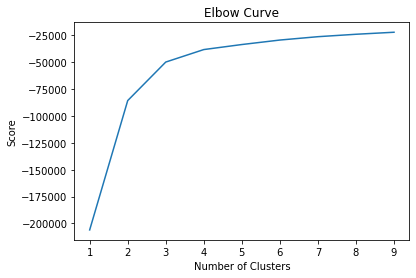

In [ ]:
Nc = range(1,10)
kmeans = [KMeans(n_clusters=i) for i in Nc]
kmeans
score = [kmeans[i].fit(Var_Num).score(Var_Num) for i in range(len(kmeans))]
score
plt.plot(Nc,score)
plt.xlabel('Number of Clusters')
plt.ylabel('Score')
plt.title('Elbow Curve')
plt.show()



Con la anterior grafica, se puede observar que el "punto de codo" se da en el 4 como un buen número para K.

A continuación se realizara el algoritmo para 4 cluters y se obtendrá las etiquetas y los centroids.

In [ ]:
kmeans = KMeans(n_clusters=4).fit(Var_Num)
centroids = kmeans.cluster_centers_
print(centroids)


[[1.82603701e+00 1.02010421e+00 1.07093915e+00 1.97936438e-01
  3.68829952e-03 6.35928342e-05 9.06934887e-01]
 [5.82043133e+00 2.57457435e+00 3.35550511e+00 5.16167804e-01
  4.53301771e-03 6.91405450e-07 9.19687628e-01]
 [3.87805752e+00 1.60872682e+00 2.07275334e+00 3.90623907e-01
  3.79988420e-03 6.73698863e-07 9.13803423e-01]
 [8.68355641e+00 3.81835564e+00 5.69407266e+00 6.14437911e-01
  3.43674499e-03 6.37130020e-07 9.13678776e-01]]


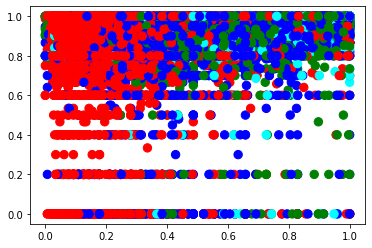

In [ ]:
# Getting the values and plotting it
labels = kmeans.predict(Var_Num)
f1 = Var_Num['price'].values
f2 = Var_Num['review_scores_rating'].values
C = kmeans.cluster_centers_
colores=['red','green','blue','cyan','yellow']
asignar=[]
for row in labels:
    asignar.append(colores[row])
 
plt.scatter(f1, f2, c=asignar, s=70)
plt.show()

In [ ]:
np.unique(labels)

array([0, 1, 2, 3], dtype=int32)

In [ ]:
Pred=lista
Pred['Pred']=labels

In [ ]:
Pred=Pred.assign(CalidadPrecio=(Pred['review_scores_rating']/Pred['price']))

D1=Pred[Pred['Pred']==0]
D2=Pred[Pred['Pred']==1]
D3=Pred[Pred['Pred']==2]
D4=Pred[Pred['Pred']==3]
D1.reset_index(drop=True, inplace=True)
D2.reset_index(drop=True, inplace=True)
D3.reset_index(drop=True, inplace=True)
D4.reset_index(drop=True, inplace=True)

Después de la segmentación, graficaré el mapa dividido por zonas, donde cada zona tiene marcadores de diferentes colores

In [ ]:

mapa = folium.Map(location=[51.5072,  -0.1275 ], zoom_start=13)


for i in range(0,100):
  tooltip = i
  folium.Marker([D1['latitude'][i],D1['longitude'][i]], popup=lista_original['listing_url'][i], tooltip=tooltip,icon=folium.Icon(color="blue")).add_to(mapa)

for i in range(0,100):
  tooltip = i
  folium.Marker([D2['latitude'][i],D2['longitude'][i]], popup=lista_original['listing_url'][i], tooltip=tooltip,icon=folium.Icon(color="red")).add_to(mapa)

for i in range(0,100):
  tooltip = i
  folium.Marker([D3['latitude'][i],D3['longitude'][i]], popup=lista_original['listing_url'][i], tooltip=tooltip,icon=folium.Icon(color="green")).add_to(mapa)

for i in range(0,100):
  tooltip = i
  folium.Marker([D4['latitude'][i],D4['longitude'][i]], popup=lista_original['listing_url'][i], tooltip=tooltip,icon=folium.Icon(color="black")).add_to(mapa)
mapa

Ahora miremos la distribución de precios por zona

In [ ]:
D1['price'].astype('float').describe()

count    24373.000000
mean        65.797440
std         43.304866
min          8.000000
25%         35.000000
50%         52.000000
75%         85.000000
max        300.000000
Name: price, dtype: float64

In [ ]:
D2['price'].astype('float').describe()

count    4405.000000
mean      158.720999
std        61.877520
min         8.000000
25%       113.000000
50%       150.000000
75%       200.000000
max       300.000000
Name: price, dtype: float64

In [ ]:
D3['price'].astype('float').describe()

count    11161.000000
mean       122.062181
std         55.831654
min          8.000000
25%         81.000000
50%        110.000000
75%        150.000000
max        300.000000
Name: price, dtype: float64

In [ ]:
D4['price'].astype('float').describe()

count    1046.00000
mean      187.41587
std        66.67176
min         8.00000
25%       143.25000
50%       190.00000
75%       235.00000
max       300.00000
Name: price, dtype: float64

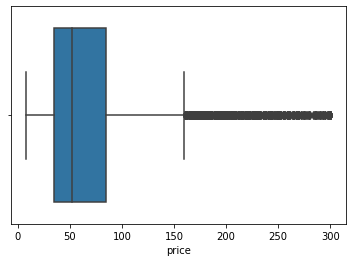

In [ ]:
sns.boxplot(D1['price'])

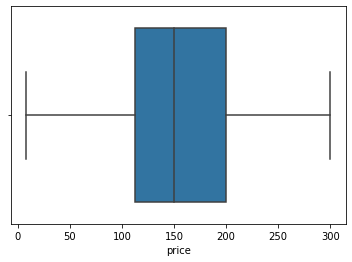

In [ ]:
sns.boxplot(D2['price'])

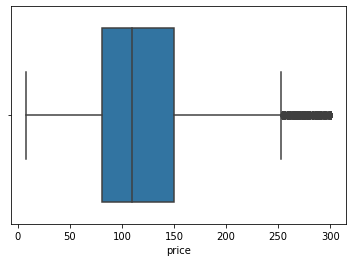

In [ ]:
sns.boxplot(D3['price'])

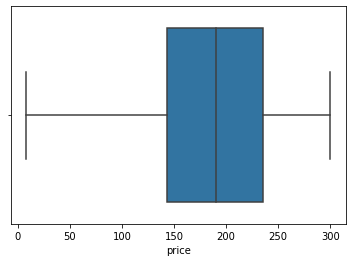

In [ ]:
sns.boxplot(D4['price'])

Con la siguiente función si podemos concluir que hay una variación significativa en el precio entre las diferentes zonas.

In [ ]:
def Hipotesis_Precio_Zonas(Z1,Z2,confianza):
 
   x=Z1['price']
   y=Z2['price']
   z_score, p_valor = sm.stats.ztest(x, y,value=0,alternative='two-sided')
   resultado =  'ninguna'
   
   if p_valor <= (1-confianza)/2:
     if x.mean()>y.mean():
       resultado= 'Z1'
     else:
         resultado='Z2'

   return resultado

In [ ]:
print(Hipotesis_Precio_Zonas(D1,D2,95),Hipotesis_Precio_Zonas(D3,D2,95),Hipotesis_Precio_Zonas(D4,D2,95),Hipotesis_Precio_Zonas(D1,D3,95),Hipotesis_Precio_Zonas(D3,D4,95),Hipotesis_Precio_Zonas(D1,D4,95))

ninguna ninguna ninguna ninguna ninguna ninguna


Lo anterior indica que no hay diferencia de precios significativa entre dos zonas, lo cual muestra que en cada zona hay alojamientos con precios similares con respecto a las otras. Ahora se tiene en cuenta el puntaje que proporciona la página, por lo cual usaremos la columna anteriormente creada para ver los 10 hospedajes con mejor **calidad precio**.

In [ ]:
D1=D1.sort_values('CalidadPrecio',ascending=False)
D2=D2.sort_values('CalidadPrecio',ascending=False)
D3=D3.sort_values('CalidadPrecio',ascending=False)
D4=D4.sort_values('CalidadPrecio',ascending=False)
D1.reset_index(drop=True, inplace=True)
D2.reset_index(drop=True, inplace=True)
D3.reset_index(drop=True, inplace=True)
D4.reset_index(drop=True, inplace=True)


In [ ]:
mapa = folium.Map(location=[51.5072,  -0.1275 ], zoom_start=13)
for i in range(10):
  tooltip = i
  folium.Marker([D1['latitude'][i],D1['longitude'][i]], popup=lista_original['listing_url'][i], tooltip=tooltip,icon=folium.Icon(color="blue")).add_to(mapa)

for i in range(10):
  tooltip = i
  folium.Marker([D2['latitude'][i],D2['longitude'][i]], popup=lista_original['listing_url'][i], tooltip=tooltip,icon=folium.Icon(color="red")).add_to(mapa)

for i in range(10):
  tooltip = i
  folium.Marker([D3['latitude'][i],D3['longitude'][i]], popup=lista_original['listing_url'][i], tooltip=tooltip,icon=folium.Icon(color="green")).add_to(mapa)

for i in range(10):
  tooltip = i
  folium.Marker([D4['latitude'][i],D4['longitude'][i]], popup=lista_original['listing_url'][i], tooltip=tooltip,icon=folium.Icon(color="black")).add_to(mapa)
mapa

# Conclusiones
Después del análisis realizado a los datos, podemos concluir lo siguiente:


*   Se encontró que el mejor modelo que predice los precios de los inmuebles fueron los bosques aleatorios.
*   Por lo visto en la prueba de hipótesis, podemos asegurar que no hay evidencia de que haya alguna zona con precio promedio significativamente diferente a las 
demás.
*   De la conclusión anterior podemos deducir que en todas las zonas hay buenos alojamientos, los cuales serian los mostrados en el mapa.
* Por último, se pudo ver que las principales características que 
afectan el precio de alojamiento es el número de huéspedes y número de camas. Además, teniendo estos datos, podemos tener un aproximado del precio gracias los modelos regresion previamente entrenados.

# Link video 


---
https://youtu.be/v45y1yHfGIg
